<a href="https://colab.research.google.com/github/njeri-max/Loan_Predictability_Analysis/blob/main/Loan_Repayment_Prediction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Download the Dataset from Kaggle

In [ ]:
!pip install opendatasets --upgrade --quiet

In [ ]:
import opendatasets as od

In [ ]:
od.version()

'0.1.22'

In [ ]:
dataset_url = 'https://www.kaggle.com/datasets/nikhil1e9/loan-default'

In [ ]:
od.download(dataset_url)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: cynthiawanjiru99
Your Kaggle Key: ··········
Dataset URL: https://www.kaggle.com/datasets/nikhil1e9/loan-default


100%|██████████| 7.86M/7.86M [00:00<00:00, 50.9MB/s]

In [ ]:
import os

In [ ]:
data_dir = 'loan-default'

In [ ]:
os.listdir(data_dir)

['Loan_default.csv']

In [ ]:
train_csv = data_dir + '/Loan_default.csv'

In [ ]:
import pandas as pd

In [ ]:
loan_df = pd.read_csv(train_csv)

In [ ]:
loan_df

,LoanID,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Education,EmploymentType,MaritalStatus,HasMortgage,HasDependents,LoanPurpose,HasCoSigner,Default
0,I38PQUQS96,56,85994,50587,520,80,4,15.23,36,0.44,Bachelor's,Full-time,Divorced,Yes,Yes,Other,Yes,0
1,HPSK72WA7R,69,50432,124440,458,15,1,4.81,60,0.68,Master's,Full-time,Married,No,No,Other,Yes,0
2,C1OZ6DPJ8Y,46,84208,129188,451,26,3,21.17,24,0.31,Master's,Unemployed,Divorced,Yes,Yes,Auto,No,1
3,V2KKSFM3UN,32,31713,44799,743,0,3,7.07,24,0.23,High School,Full-time,Married,No,No,Business,No,0
4,EY08JDHTZP,60,20437,9139,633,8,4,6.51,48,0.73,Bachelor's,Unemployed,Divorced,No,Yes,Auto,No,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
255342,8C6S86ESGC,19,37979,210682,541,109,4,14.11,12,0.85,Bachelor's,Full-time,Married,No,No,Other,No,0
255343,98R4KDHNND,32,51953,189899,511,14,2,11.55,24,0.21,High School,Part-time,Divorced,No,No,Home,No,1
255344,XQK1UUUNGP,56,84820,208294,597,70,3,5.29,60,0.50,High School,Self-employed,Married,Yes,Yes,Auto,Yes,0
255345,JAO28CPL4H,42,85109,60575,809,40,1,20.90,48,0.44,High School,Part-time,Single,Yes,Yes,Other,No,0


 # 1. Exlploratory Data Analysis and Visualization:

In [ ]:
loan_df.info()

#from the data all values are in place

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 255347 entries, 0 to 255346
Data columns (total 18 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   LoanID          255347 non-null  object 
 1   Age             255347 non-null  int64  
 2   Income          255347 non-null  int64  
 3   LoanAmount      255347 non-null  int64  
 4   CreditScore     255347 non-null  int64  
 5   MonthsEmployed  255347 non-null  int64  
 6   NumCreditLines  255347 non-null  int64  
 7   InterestRate    255347 non-null  float64
 8   LoanTerm        255347 non-null  int64  
 9   DTIRatio        255347 non-null  float64
 10  Education       255347 non-null  object 
 11  EmploymentType  255347 non-null  object 
 12  MaritalStatus   255347 non-null  object 
 13  HasMortgage     255347 non-null  object 
 14  HasDependents   255347 non-null  object 
 15  LoanPurpose     255347 non-null  object 
 16  HasCoSigner     255347 non-null  object 
 17  Default   

In [ ]:
loan_df.describe()

#the statistical ranges in the columns seem to be reasonable

,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Default
count,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000
mean,43.498306,82499.304597,127578.865512,574.264346,59.541976,2.501036,13.492773,36.025894,0.500212,0.116128
std,14.990258,38963.013729,70840.706142,158.903867,34.643376,1.117018,6.636443,16.969330,0.230917,0.320379
min,18.000000,15000.000000,5000.000000,300.000000,0.000000,1.000000,2.000000,12.000000,0.100000,0.000000
25%,31.000000,48825.500000,66156.000000,437.000000,30.000000,2.000000,7.770000,24.000000,0.300000,0.000000
50%,43.000000,82466.000000,127556.000000,574.000000,60.000000,2.000000,13.460000,36.000000,0.500000,0.000000
75%,56.000000,116219.000000,188985.000000,712.000000,90.000000,3.000000,19.250000,48.000000,0.700000,0.000000
max,69.000000,149999.000000,249999.000000,849.000000,119.000000,4.000000,25.000000,60.000000,0.900000,1.000000


In [ ]:
# check for duplicate values
loan_df.duplicated().sum()

0

In [ ]:
# import visualization libraries
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [ ]:
# factoring in chart improvement settings
#settings that improve our charts
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

##### Age

In [ ]:
# Viualize age statistics
loan_df['Age'].describe()

# max_age guaranteed a loan is: 69
# min_age guaranteed a loan is: 18

count    255347.000000
mean         43.498306
std          14.990258
min          18.000000
25%          31.000000
50%          43.000000
75%          56.000000
max          69.000000
Name: Age, dtype: float64

In [ ]:
# Visualize the distribution of age

fig = px.histogram(loan_df, x='Age', marginal='box', nbins=50, title='Age Distribution')
fig.update_layout(bargap=0.1)
fig.show()

In [ ]:
loan_df.columns

Index(['LoanID', 'Age', 'Income', 'LoanAmount', 'CreditScore',
       'MonthsEmployed', 'NumCreditLines', 'InterestRate', 'LoanTerm',
       'DTIRatio', 'Education', 'EmploymentType', 'MaritalStatus',
       'HasMortgage', 'HasDependents', 'LoanPurpose', 'HasCoSigner',
       'Default'],
      dtype='object')

In [ ]:

fig = px.histogram(loan_df, x='Income', marginal='box', nbins=50,
                   title='Income Distribution')
fig.update_layout(bargap=0.1)
fig.show()

In [ ]:

fig = px.histogram(loan_df, x='Education', marginal='box', nbins=50,
                   title='Education Distribution')
fig.update_layout(bargap=0.1)
fig.show()

In [ ]:
list(loan_df['Education'].unique())

["Bachelor's", "Master's", 'High School', 'PhD']

In [ ]:
#Distributin of income in different education levels
fig = px.histogram(loan_df, x='Income', marginal='box', color='Education',
                   color_discrete_map={"Bachelor's": 'green',  "Master's": 'red',
                                       'High School': 'blue', 'PhD': 'yellow'},
                   title='Income Distribution')
fig.update_layout(bargap=0.1)
fig.show()

In [ ]:
loan_df['LoanPurpose'].unique()

array(['Other', 'Auto', 'Business', 'Home', 'Education'], dtype=object)

In [ ]:
loan_df['InterestRate'].unique()

array([15.23,  4.81, 21.17, ...,  2.46, 19.81,  9.01])

In [ ]:
loan_df['HasMortgage'].unique()

array(['Yes', 'No'], dtype=object)

In [ ]:
loan_df['HasCoSigner'].unique()

array(['Yes', 'No'], dtype=object)

In [ ]:
#Visualization of Eduxcation Distribution depending on whether an applicant has mortgage or not
fig = px.histogram(loan_df, x='Education', marginal='box', color='HasMortgage',
                   color_discrete_map={'Yes':'green', 'No':'red'},
                   title='Education Distribution depending on whether applicants has mortgage or not')
fig.update_layout(bargap=0.1)
fig.show()

In [ ]:
fig = px.histogram(loan_df,
                  x='InterestRate',
                  marginal='box',
                  color='HasCoSigner',
                  color_discrete_map={'Yes':'green', 'No': 'red'},
                  title='Interest Rates')
fig.update_layout(bargap=0.1)
fig.show()

In [ ]:

fig = px.histogram(loan_df, x='HasCoSigner', marginal='box', nbins=50,
                   title='Education Distribution')
fig.update_layout(bargap=0.1)
fig.show()

In [ ]:
loan_df.HasCoSigner.value_counts()

HasCoSigner
Yes    127701
No     127646
Name: count, dtype: int64

In [ ]:
px.histogram(loan_df, x='HasCoSigner', color='MaritalStatus', title='cosigner distribution')

In [ ]:
loan_df.LoanPurpose.value_counts()

LoanPurpose
Business     51298
Home         51286
Education    51005
Other        50914
Auto         50844
Name: count, dtype: int64

In [ ]:
px.histogram(loan_df, x='LoanPurpose', title='Loan Purpose Distribution')

In [ ]:
fig = px.scatter(loan_df,
                x='Age',
                y='Default',
                color='HasCoSigner',
                opacity=0.8,
                hover_data=['HasMortgage'],
                title='Age Vs. Default')
fig.update_traces(marker_size=5)
fig.show()

In [ ]:
fig = px.scatter(loan_df,
                x='Income',
                y='Default',
                color='MaritalStatus',
                opacity=0.8,
                #hover_data=['HasMortgage'],
                title='Income Vs. Default')
fig.update_traces(marker_size=5)
fig.show()

In [ ]:
fig = px.violin(loan_df,
                x='Income',
                y='Default',
                #color='smoker',
                #opacity=0.8,
                #hover_data=['sex'],
                title='Income Vs. Default')
fig.update_traces(marker_size=5)
fig.show()

# Train, Validation and Test sets

Training set - used to train the model, i.e., compute the loss and adjust the model's weights using an optimization technique.

Validation set - used to evaluate the model during training, tune model hyperparameters (optimization technique, regularization etc.), and pick the best version of the model. Picking a good validation set is essential for training models that generalize well.

Test set - used to compare different models or approaches and report the model's final accuracy. For many datasets, test sets are provided separately. The test set should reflect the kind of data the model will encounter in the real-world, as closely as feasible.

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
loan_df.head()

,LoanID,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Education,EmploymentType,MaritalStatus,HasMortgage,HasDependents,LoanPurpose,HasCoSigner,Default
0,I38PQUQS96,56,85994,50587,520,80,4,15.23,36,0.44,Bachelor's,Full-time,Divorced,Yes,Yes,Other,Yes,0
1,HPSK72WA7R,69,50432,124440,458,15,1,4.81,60,0.68,Master's,Full-time,Married,No,No,Other,Yes,0
2,C1OZ6DPJ8Y,46,84208,129188,451,26,3,21.17,24,0.31,Master's,Unemployed,Divorced,Yes,Yes,Auto,No,1
3,V2KKSFM3UN,32,31713,44799,743,0,3,7.07,24,0.23,High School,Full-time,Married,No,No,Business,No,0
4,EY08JDHTZP,60,20437,9139,633,8,4,6.51,48,0.73,Bachelor's,Unemployed,Divorced,No,Yes,Auto,No,0



 Try splitting the data into three parts: Train, Validation and Test datasets each with a ratio of 60:20:20 respectifully
> Add blockquote



In [ ]:
train_val_df, test_df = train_test_split(loan_df, test_size=0.2, random_state=42)
train_df, val_df = train_test_split(train_val_df, test_size=0.25, random_state=42)

In [ ]:
print('train_df.shape : ', train_df.shape)
print('val_df.shape : ', val_df.shape)
print('test_df.shape : ', test_df.shape)

train_df.shape :  (153207, 18)
val_df.shape :  (51070, 18)
test_df.shape :  (51070, 18)


### Sampling the input and target columns

not all columns in the dataset are useful in tarining a model

In [ ]:
#Ignore the ID column since it will not be of much use in creating an effective model
input_cols = list(train_df.columns)[1: -1]
target_col ='Default'

In [ ]:
print(input_cols)

['Age', 'Income', 'LoanAmount', 'CreditScore', 'MonthsEmployed', 'NumCreditLines', 'InterestRate', 'LoanTerm', 'DTIRatio', 'Education', 'EmploymentType', 'MaritalStatus', 'HasMortgage', 'HasDependents', 'LoanPurpose', 'HasCoSigner']


In [ ]:
target_col

'Default'

In [ ]:
# creating the inputs and targets for the training, validation and test sets
#for processing and modeling
# remember to copy so as not to affect the rest of the data

In [ ]:
train_inputs = train_df[input_cols].copy()
train_targets = train_df[target_col].copy()

In [ ]:
val_inputs = val_df[input_cols].copy()
val_targets = val_df[target_col].copy()

In [ ]:
test_inputs = test_df[input_cols].copy()
test_targets = test_df[target_col].copy()

In [ ]:
train_inputs.head()

,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Education,EmploymentType,MaritalStatus,HasMortgage,HasDependents,LoanPurpose,HasCoSigner
232957,36,64890,56766,590,48,1,5.19,12,0.12,PhD,Unemployed,Divorced,No,No,Home,Yes
91325,27,72249,195503,442,48,1,17.44,60,0.78,Bachelor's,Self-employed,Divorced,No,No,Other,Yes
196482,59,45415,59948,356,36,2,16.13,48,0.79,Master's,Full-time,Divorced,Yes,No,Auto,No
37165,61,66972,58014,301,108,1,11.70,36,0.11,PhD,Full-time,Divorced,No,No,Auto,No
122776,34,68921,136945,466,37,4,12.83,24,0.29,Bachelor's,Full-time,Single,Yes,No,Auto,Yes


In [ ]:
train_targets

232957    0
91325     1
196482    0
37165     0
122776    0
         ..
153110    0
175153    0
77911     0
207122    0
234260    0
Name: Default, Length: 153207, dtype: int64

#### Identify which columns are numerical and which are categorical

In [ ]:
import numpy as np

In [ ]:
numeric_cols = train_inputs.select_dtypes(include=np.number).columns.tolist()
categorical_cols = train_inputs.select_dtypes('object').columns.tolist()

In [ ]:
# Stats for numeric columns
# the values are  somehow reasonable
train_df[numeric_cols].describe()

,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio
count,153207.000000,153207.000000,153207.000000,153207.000000,153207.000000,153207.000000,153207.000000,153207.000000,153207.000000
mean,43.479998,82493.879444,127572.809950,574.063489,59.522463,2.503228,13.479658,36.007363,0.500568
std,14.991503,38929.704349,70790.510069,158.805036,34.646342,1.117627,6.642604,16.949502,0.230850
min,18.000000,15000.000000,5001.000000,300.000000,0.000000,1.000000,2.000000,12.000000,0.100000
25%,31.000000,48885.000000,66061.500000,437.000000,30.000000,2.000000,7.750000,24.000000,0.300000
50%,43.000000,82436.000000,127587.000000,573.000000,60.000000,3.000000,13.430000,36.000000,0.500000
75%,56.000000,116238.000000,188803.000000,712.000000,90.000000,4.000000,19.240000,48.000000,0.700000
max,69.000000,149999.000000,249997.000000,849.000000,119.000000,4.000000,25.000000,60.000000,0.900000


In [ ]:
# check the number of categories in the categorical columns
train_inputs[categorical_cols].nunique()

Education         4
EmploymentType    4
MaritalStatus     3
HasMortgage       2
HasDependents     2
LoanPurpose       5
HasCoSigner       2
dtype: int64

In [ ]:
# check whether there are missing values in the numeric columns
# Luckily all the values are present
# there is no need for imputation
loan_df[numeric_cols].isna().sum()

Age               0
Income            0
LoanAmount        0
CreditScore       0
MonthsEmployed    0
NumCreditLines    0
InterestRate      0
LoanTerm          0
DTIRatio          0
dtype: int64

In [ ]:
# check for missing values, just to be safe in the train, val and test data
train_inputs[numeric_cols].isna().sum()

Age               0
Income            0
LoanAmount        0
CreditScore       0
MonthsEmployed    0
NumCreditLines    0
InterestRate      0
LoanTerm          0
DTIRatio          0
dtype: int64

### Scaling Numeric features

This will ensure that all features are propotionate in impacting the model's loss. optimization will work better with smaller numbers

In [ ]:
loan_df[numeric_cols].describe()

,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio
count,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000,255347.000000
mean,43.498306,82499.304597,127578.865512,574.264346,59.541976,2.501036,13.492773,36.025894,0.500212
std,14.990258,38963.013729,70840.706142,158.903867,34.643376,1.117018,6.636443,16.969330,0.230917
min,18.000000,15000.000000,5000.000000,300.000000,0.000000,1.000000,2.000000,12.000000,0.100000
25%,31.000000,48825.500000,66156.000000,437.000000,30.000000,2.000000,7.770000,24.000000,0.300000
50%,43.000000,82466.000000,127556.000000,574.000000,60.000000,2.000000,13.460000,36.000000,0.500000
75%,56.000000,116219.000000,188985.000000,712.000000,90.000000,3.000000,19.250000,48.000000,0.700000
max,69.000000,149999.000000,249999.000000,849.000000,119.000000,4.000000,25.000000,60.000000,0.900000


In [ ]:
from sklearn.preprocessing import MinMaxScaler

In [ ]:
scaler = MinMaxScaler()

In [ ]:
# fit the scaler into the data
scaler.fit(loan_df[numeric_cols])

MinMaxScaler()

In [ ]:
# View the maximum and minimum values in each columns
print('Minimum: ')
list(scaler.data_min_)

Minimum: 


[18.0, 15000.0, 5000.0, 300.0, 0.0, 1.0, 2.0, 12.0, 0.1]

In [ ]:
print('Maximum: ')
list(scaler.data_max_)

Maximum: 


[69.0, 149999.0, 249999.0, 849.0, 119.0, 4.0, 25.0, 60.0, 0.9]

In [ ]:
# scale the train, val and test datasets using transform method
train_inputs[numeric_cols] = scaler.transform(train_inputs[numeric_cols])
val_inputs[numeric_cols] = scaler.transform(val_inputs[numeric_cols])
test_inputs[numeric_cols] = scaler.transform(test_inputs[numeric_cols])

In [ ]:
# verify that the columns have transformed(0, 1 ranges)
train_inputs[numeric_cols].describe()

,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio
count,153207.000000,153207.000000,153207.000000,153207.000000,153207.000000,153207.000000,153207.000000,153207.000000,153207.000000
mean,0.499608,0.499958,0.500299,0.499205,0.500189,0.501076,0.499116,0.500153,0.500710
std,0.293951,0.288370,0.288942,0.289262,0.291146,0.372542,0.288809,0.353115,0.288562
min,0.000000,0.000000,0.000004,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.254902,0.251002,0.249232,0.249545,0.252101,0.333333,0.250000,0.250000,0.250000
50%,0.490196,0.499530,0.500357,0.497268,0.504202,0.666667,0.496957,0.500000,0.500000
75%,0.745098,0.749917,0.750219,0.750455,0.756303,1.000000,0.749565,0.750000,0.750000
max,1.000000,1.000000,0.999992,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


### Encoding categorical data

In [ ]:
loan_df[categorical_cols].nunique()

Education         4
EmploymentType    4
MaritalStatus     3
HasMortgage       2
HasDependents     2
LoanPurpose       5
HasCoSigner       2
dtype: int64

In [ ]:
from sklearn.preprocessing import OneHotEncoder

In [ ]:
encoder = OneHotEncoder(sparse=False, handle_unknown='ignore')

In [ ]:
encoder.fit(loan_df[categorical_cols])

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning:

`sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.



OneHotEncoder(handle_unknown='ignore', sparse=False, sparse_output=False)

In [ ]:
encoder.categories_

[array(["Bachelor's", 'High School', "Master's", 'PhD'], dtype=object),
 array(['Full-time', 'Part-time', 'Self-employed', 'Unemployed'],
       dtype=object),
 array(['Divorced', 'Married', 'Single'], dtype=object),
 array(['No', 'Yes'], dtype=object),
 array(['No', 'Yes'], dtype=object),
 array(['Auto', 'Business', 'Education', 'Home', 'Other'], dtype=object),
 array(['No', 'Yes'], dtype=object)]

In [ ]:
# Generating column names for each individual using
encoded_cols = list(encoder.get_feature_names_out(categorical_cols))
print(encoded_cols)

["Education_Bachelor's", 'Education_High School', "Education_Master's", 'Education_PhD', 'EmploymentType_Full-time', 'EmploymentType_Part-time', 'EmploymentType_Self-employed', 'EmploymentType_Unemployed', 'MaritalStatus_Divorced', 'MaritalStatus_Married', 'MaritalStatus_Single', 'HasMortgage_No', 'HasMortgage_Yes', 'HasDependents_No', 'HasDependents_Yes', 'LoanPurpose_Auto', 'LoanPurpose_Business', 'LoanPurpose_Education', 'LoanPurpose_Home', 'LoanPurpose_Other', 'HasCoSigner_No', 'HasCoSigner_Yes']


In [ ]:
train_inputs[encoded_cols]=encoder.transform(train_inputs[categorical_cols])
val_inputs[encoded_cols]=encoder.transform(val_inputs[categorical_cols])
test_inputs[encoded_cols]=encoder.transform(test_inputs[categorical_cols])

In [ ]:
train_inputs

,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Education,...,HasMortgage_Yes,HasDependents_No,HasDependents_Yes,LoanPurpose_Auto,LoanPurpose_Business,LoanPurpose_Education,LoanPurpose_Home,LoanPurpose_Other,HasCoSigner_No,HasCoSigner_Yes
232957,0.352941,0.369558,0.211291,0.528233,0.403361,0.000000,0.138696,0.00,0.0250,PhD,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0
91325,0.176471,0.424070,0.777566,0.258652,0.403361,0.000000,0.671304,1.00,0.8500,Bachelor's,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
196482,0.803922,0.225298,0.224278,0.102004,0.302521,0.333333,0.614348,0.75,0.8625,Master's,...,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
37165,0.843137,0.384981,0.216385,0.001821,0.907563,0.000000,0.421739,0.50,0.0125,PhD,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0
122776,0.313725,0.399418,0.538553,0.302368,0.310924,1.000000,0.470870,0.25,0.2375,Bachelor's,...,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
153110,0.745098,0.598012,0.300201,0.510018,0.445378,0.333333,0.495217,0.75,0.5500,Bachelor's,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0
175153,0.274510,0.232668,0.091882,0.908925,0.478992,1.000000,0.530435,0.75,0.3875,Master's,...,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
77911,0.705882,0.945214,0.703742,0.398907,0.168067,0.666667,0.377826,0.00,0.4625,PhD,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
207122,0.627451,0.628345,0.640766,0.570128,0.512605,0.666667,0.448261,0.75,0.5750,High School,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0


In [ ]:
test_inputs

,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Education,...,HasMortgage_Yes,HasDependents_No,HasDependents_Yes,LoanPurpose_Auto,LoanPurpose_Business,LoanPurpose_Education,LoanPurpose_Home,LoanPurpose_Other,HasCoSigner_No,HasCoSigner_Yes
51139,0.725490,0.723383,0.356708,0.511840,0.949580,0.333333,0.936522,0.50,0.0625,PhD,...,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0
71005,0.745098,0.567182,0.516635,0.621129,0.453782,0.000000,0.573478,0.00,0.4125,High School,...,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
35684,0.156863,0.467922,0.287417,0.489982,0.882353,0.666667,0.696522,0.00,0.2375,Master's,...,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
174087,0.156863,0.355803,0.023690,0.047359,0.991597,0.000000,0.552609,0.25,0.3875,High School,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
137952,0.117647,0.108630,0.066049,0.659381,0.857143,0.666667,0.566087,1.00,0.7375,PhD,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35991,0.647059,0.625731,0.674913,0.597450,0.201681,0.000000,0.653478,0.00,0.4500,PhD,...,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0
69680,0.215686,0.200120,0.433936,0.129326,0.428571,1.000000,0.221739,0.50,0.5000,PhD,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
184743,0.960784,0.544500,0.561904,0.785064,0.428571,0.000000,0.908261,0.75,0.8625,Bachelor's,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
209406,0.470588,0.752961,0.758934,0.342441,0.050420,0.000000,0.383913,1.00,0.2750,Bachelor's,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0


## Saving the processed data to disk

In [ ]:
print('train_inputs:', train_inputs.shape)
print('train_targets:', train_targets.shape)
print('val_inputs:', val_inputs.shape)
print('val_targets:', val_targets.shape)
print('test_inputs:', test_inputs.shape)
print('test_targets:', test_targets.shape)

train_inputs: (153207, 38)
train_targets: (153207,)
val_inputs: (51070, 38)
val_targets: (51070,)
test_inputs: (51070, 38)
test_targets: (51070,)


In [ ]:
train_inputs.to_parquet('train_inputs.parquet')
val_inputs.to_parquet('val_inputs.parquet')
test_inputs.to_parquet('test_inputs.parquet')

In [ ]:
%%time
pd.DataFrame(train_targets).to_parquet('train_targets.parquet')
pd.DataFrame(val_targets).to_parquet('val_targets.parquet')
pd.DataFrame(test_targets).to_parquet('test_targets.parquet')

CPU times: user 65.4 ms, sys: 29.9 ms, total: 95.3 ms
Wall time: 98.4 ms


In [ ]:
# reading the data back
%%time

train_inputs = pd.read_parquet('train_inputs.parquet')
val_inputs = pd.read_parquet('val_inputs.parquet')
test_inputs = pd.read_parquet('test_inputs.parquet')

train_targets = pd.read_parquet('train_targets.parquet')[target_col]
val_targets = pd.read_parquet('val_targets.parquet')[target_col]
test_targets = pd.read_parquet('test_targets.parquet')[target_col]

CPU times: user 296 ms, sys: 111 ms, total: 407 ms
Wall time: 801 ms


In [ ]:
# Verifying data loading
print('train_inputs:', train_inputs.shape)
print('train_targets:', train_targets.shape)
print('val_inputs:', val_inputs.shape)
print('val_targets:', val_targets.shape)
print('test_inputs:', test_inputs.shape)
print('test_targets:', test_targets.shape)

train_inputs: (153207, 38)
train_targets: (153207,)
val_inputs: (51070, 38)
val_targets: (51070,)
test_inputs: (51070, 38)
test_targets: (51070,)


# Training a Logistic Regression Model

## Training a Logistic Regression Model

Logistic regression is a commonly used technique for solving binary classification problems. In a logistic regression model:

- we take linear combination (or weighted sum of the input features)
- we apply the sigmoid function to the result to obtain a number between 0 and 1
- this number represents the probability of the input being classified as "Yes"
- instead of RMSE, the cross entropy loss function is used to evaluate the results


In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
model = LogisticRegression(solver='lbfgs')

In [ ]:
model.fit(train_inputs[numeric_cols + encoded_cols], train_targets)

LogisticRegression()

model.fit applies:

1. We initialize a model with random parameters (weights & biases).
2. We pass some inputs into the model to obtain predictions.
3. We compare the model's predictions with the actual targets using the loss function.  
4. We use an optimization technique (like least squares, gradient descent etc.) to reduce the loss by adjusting the weights & biases of the model
5. We repeat steps 1 to 4 till the predictions from the model are good enough.



In [ ]:
print(numeric_cols + encoded_cols)

['Age', 'Income', 'LoanAmount', 'CreditScore', 'MonthsEmployed', 'NumCreditLines', 'InterestRate', 'LoanTerm', 'DTIRatio', "Education_Bachelor's", 'Education_High School', "Education_Master's", 'Education_PhD', 'EmploymentType_Full-time', 'EmploymentType_Part-time', 'EmploymentType_Self-employed', 'EmploymentType_Unemployed', 'MaritalStatus_Divorced', 'MaritalStatus_Married', 'MaritalStatus_Single', 'HasMortgage_No', 'HasMortgage_Yes', 'HasDependents_No', 'HasDependents_Yes', 'LoanPurpose_Auto', 'LoanPurpose_Business', 'LoanPurpose_Education', 'LoanPurpose_Home', 'LoanPurpose_Other', 'HasCoSigner_No', 'HasCoSigner_Yes']


In [ ]:
print(model.coef_.tolist())

[[-2.019798681512404, -1.229812824885033, 1.003441294071251, -0.41722405311619515, -1.138993628959875, 0.25137850089744496, 1.5611652971277385, 0.009398816455015458, 0.23411504552387755, -0.05060852516329462, 0.02678532779220922, -0.18188054162600217, -0.21938453423470142, -0.35770213795134226, -0.06673523957003569, -0.10003332055316778, 0.09938242484274472, -0.044494567737208515, -0.2606106931713112, -0.119983012323283, -0.13920946542362903, -0.2858788078081548, -0.09995577305611406, -0.3251325001756871, -0.06982778689885938, 0.004470400219475665, -0.054539311898089256, -0.24919279381401027, -0.05599878084031197, -0.07276922478484034, -0.3523190484469409]]


In [ ]:
print(model.intercept_)

[-0.42694486]


In [ ]:
weights_df = pd.DataFrame(
    {'feature': np.append(numeric_cols + encoded_cols, 1),
     'weight': np.append(model.coef_, model.intercept_)}
)
weights_df.sort_values('weight', ascending=False)

,feature,weight
6,InterestRate,1.561165
2,LoanAmount,1.003441
5,NumCreditLines,0.251379
8,DTIRatio,0.234115
16,EmploymentType_Unemployed,0.099382
10,Education_High School,0.026785
7,LoanTerm,0.009399
25,LoanPurpose_Business,0.004470
17,MaritalStatus_Divorced,-0.044495
9,Education_Bachelor's,-0.050609


From this observation, the three top most important features are:
1. Interest Rates
2. LoanAmount
3. NumCreditLines

The higher the weight the greater the impact of the column on prediction

## Evaluating the model and making predictions

In [ ]:
X_train = train_inputs[numeric_cols + encoded_cols]
X_val = val_inputs[numeric_cols + encoded_cols]
X_test = test_inputs[numeric_cols + encoded_cols]

In [ ]:
train_preds  = model.predict(X_train)
train_preds

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
train_targets

232957    0
91325     1
196482    0
37165     0
122776    0
         ..
153110    0
175153    0
77911     0
207122    0
234260    0
Name: Default, Length: 153207, dtype: int64

In [ ]:
train_comparison_df = pd.DataFrame(
    {'train_pred_1': np.append(train_preds, 1),
     'train_target_1': np.append(train_targets,1)}
)
train_comparison_df

,train_pred_1,train_target_1
0,0,0
1,0,1
2,0,0
3,0,0
4,0,0
...,...,...
153203,0,0
153204,0,0
153205,0,0
153206,0,0


In [ ]:
# output a probabilistic prediction
train_probs = model.predict_proba(X_train)
train_probs

# the below indicate probabilities for target classes 0 and 1

array([[0.94505427, 0.05494573],
       [0.66333948, 0.33666052],
       [0.91297402, 0.08702598],
       ...,
       [0.94989652, 0.05010348],
       [0.93258625, 0.06741375],
       [0.93871241, 0.06128759]])

In [ ]:
model.classes_

array([0, 1])

In [ ]:
# The accuracy of the model is acquired by computing the percentage of matching values
# in train_preds and train_targets

In [ ]:
from sklearn.metrics import accuracy_score

In [ ]:
accuracy_score(train_targets, train_preds)

0.884822495055709

In [ ]:
# The model achieves an accuracy of 88.51% on the training set
# a confusion matrix is best to explain the accuracy results



<img src="https://i.imgur.com/UM28BCN.png" width="480">

In [ ]:
from sklearn.metrics import confusion_matrix

In [ ]:
confusion_matrix(train_targets, train_preds, normalize='true')

array([[0.99700844, 0.00299156],
       [0.96718277, 0.03281723]])

In [ ]:
# Create a helper function suitable for making predictions in general
def make_preds(inputs, targets, name=''):
  preds = model.predict(inputs)

  accuracy = accuracy_score(targets, preds)
  print('The accuracy is: {:.2f}%'.format(accuracy * 100))

  cf = confusion_matrix(targets, preds, normalize='true')
  plt.figure()
  sns.heatmap(cf, annot=True)
  plt.xlabel('Prediction')
  plt.ylabel('Target')
  plt.title('{} Confusion Matrix'.format(name));

  return preds

The accuracy is: 88.48%


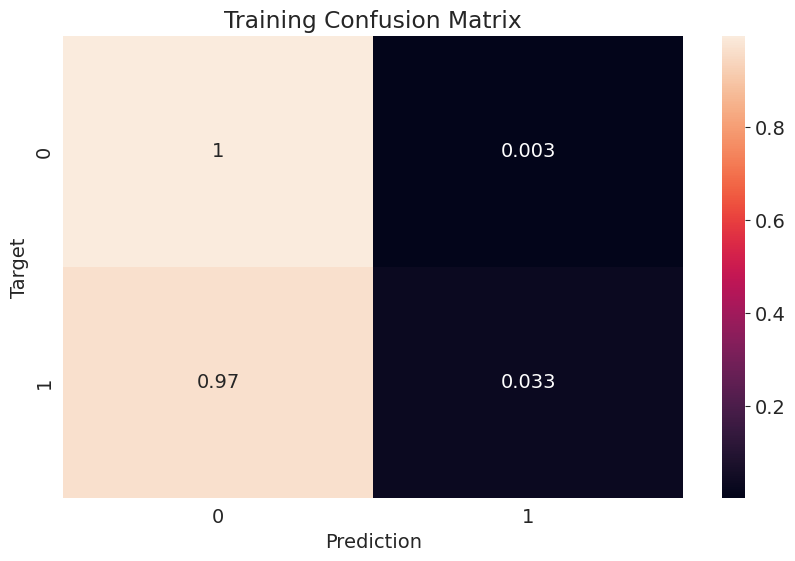

In [ ]:
train_preds = make_preds(X_train, train_targets, 'Training')

The accuracy is: 88.52%


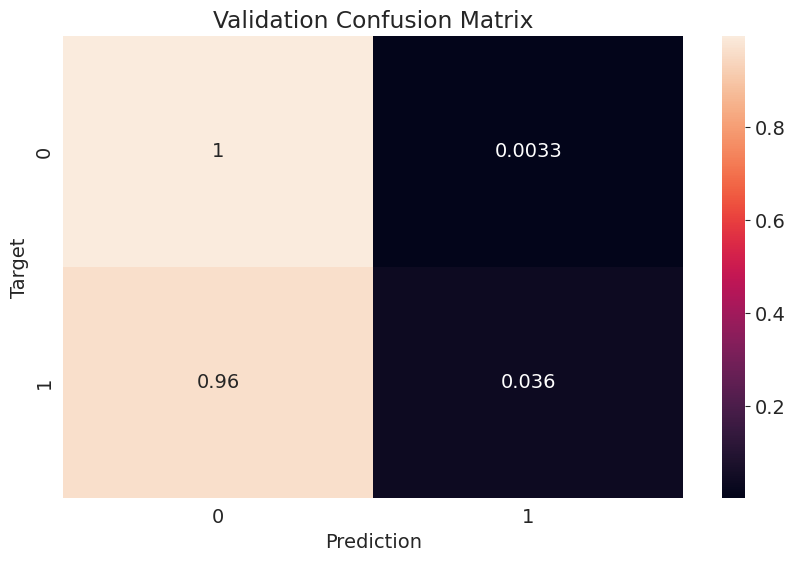

In [ ]:
# compute on the model and validation sets
val_preds = make_preds(X_val, val_targets, 'Validation')

The accuracy is: 88.58%


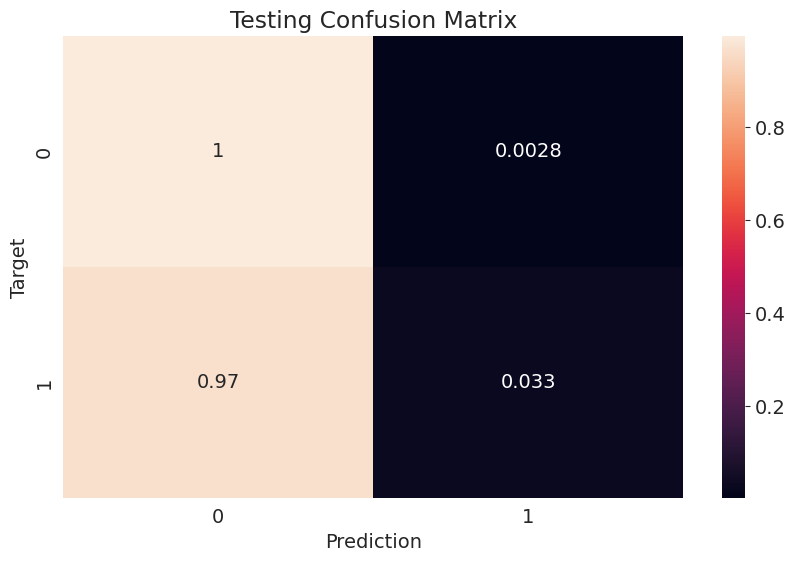

In [ ]:
test_preds = make_preds(X_test, test_targets, 'Testing')

1. The accuracy of the model on the test and validation set are above 88%, which suggests that our model generalizes well to data it hasn't seen before.
2.  A good way to verify whether a model has actually learned something useful is to compare its results to a "random" or "dumb" model.
3. Let's create two models: one that guesses randomly and another that always return "0". Both of these models completely ignore the inputs given to them.



In [ ]:
def random_guess(inputs):
  return np.random.choice([0, 1], len(inputs))

In [ ]:
def all_zero(inputs):
  return np.full(len(inputs), 0)

In [ ]:
# checking the accuracy of the dumb models on test sets
accuracy_score(test_targets, random_guess(X_test))

0.505639318582338

In [ ]:
accuracy_score(test_targets, all_zero(X_test))

0.8844722929312708

Our random model achieves an accuracy of 50% and our "always No" model achieves an accuracy of 88%.
Our model is better than the dumb models

In [ ]:
loan_df

,LoanID,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Education,EmploymentType,MaritalStatus,HasMortgage,HasDependents,LoanPurpose,HasCoSigner,Default
0,I38PQUQS96,56,85994,50587,520,80,4,15.23,36,0.44,Bachelor's,Full-time,Divorced,Yes,Yes,Other,Yes,0
1,HPSK72WA7R,69,50432,124440,458,15,1,4.81,60,0.68,Master's,Full-time,Married,No,No,Other,Yes,0
2,C1OZ6DPJ8Y,46,84208,129188,451,26,3,21.17,24,0.31,Master's,Unemployed,Divorced,Yes,Yes,Auto,No,1
3,V2KKSFM3UN,32,31713,44799,743,0,3,7.07,24,0.23,High School,Full-time,Married,No,No,Business,No,0
4,EY08JDHTZP,60,20437,9139,633,8,4,6.51,48,0.73,Bachelor's,Unemployed,Divorced,No,Yes,Auto,No,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
255342,8C6S86ESGC,19,37979,210682,541,109,4,14.11,12,0.85,Bachelor's,Full-time,Married,No,No,Other,No,0
255343,98R4KDHNND,32,51953,189899,511,14,2,11.55,24,0.21,High School,Part-time,Divorced,No,No,Home,No,1
255344,XQK1UUUNGP,56,84820,208294,597,70,3,5.29,60,0.50,High School,Self-employed,Married,Yes,Yes,Auto,Yes,0
255345,JAO28CPL4H,42,85109,60575,809,40,1,20.90,48,0.44,High School,Part-time,Single,Yes,Yes,Other,No,0


In [ ]:
# Try using the predictions on new data and play around with the features to see how the model performs
fresh_input = {'LoanID': 'HRQ23478',
               'Age': 46,
               'Income': 67890,
               'LoanAmount': 12456,
               'CreditScore': 654,
               'MonthsEmployed':28,
               'NumCreditLines':4,
               'InterestRate': 23.4,
               'LoanTerm': 36,
               'DTIRatio': 0.45,
               'Education':"Master's",
               'EmploymentType': 'Full-Time',
               'MaritalStatus': 'Married',
               #'HomeOwnership': 'Rent
               'HasMortgage':'No',
               'HasDependents':'Yes',
               'LoanPurpose': 'Business',
               'HasCoSigner': 'No'}

In [ ]:
fresh_input_df = pd.DataFrame([fresh_input])

In [ ]:
fresh_input_df

,LoanID,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Education,EmploymentType,MaritalStatus,HasMortgage,HasDependents,LoanPurpose,HasCoSigner
0,HRQ23478,46,67890,12456,654,28,4,23.4,36,0.45,Master's,Full-Time,Married,No,Yes,Business,No


In [ ]:
fresh_input_df[numeric_cols] = scaler.transform(fresh_input_df[numeric_cols])
fresh_input_df[encoded_cols] = encoder.transform(fresh_input_df[categorical_cols])

In [ ]:
X_input = fresh_input_df[numeric_cols + encoded_cols]
X_input

,Age,Income,LoanAmount,CreditScore,MonthsEmployed,NumCreditLines,InterestRate,LoanTerm,DTIRatio,Education_Bachelor's,...,HasMortgage_Yes,HasDependents_No,HasDependents_Yes,LoanPurpose_Auto,LoanPurpose_Business,LoanPurpose_Education,LoanPurpose_Home,LoanPurpose_Other,HasCoSigner_No,HasCoSigner_Yes
0,0.54902,0.391781,0.030433,0.644809,0.235294,1.0,0.930435,0.5,0.4375,0.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0


In [ ]:
prediction  = model.predict(X_input)[0]

In [ ]:
prediction

#The model predicts that the borrower will not default on their loan

0

In [ ]:
# check the probability of the prediction
prob = model.predict_proba(X_input)[0]
prob
#The probabilities are nearly accounted for meaning that the model confidence is in question

array([0.84399096, 0.15600904])

In [ ]:
#Create a helper function summarizing the inputs
def pred_inputs(single_input):
  input_df = pd.DataFrame([single_input])
  input_df[numeric_cols] = scaler.transform(input_df[numeric_cols])
  input_df[encoded_cols] = encoder.transform(input_df[categorical_cols])
  X_input = input_df[numeric_cols + encoded_cols]
  prediction  = model.predict(X_input)[0]
  prob = model.predict_proba(X_input)[0][list(model.classes_).index(prediction)]
  return prediction, prob

In [ ]:
pred_inputs(fresh_input)

#The user will not default on their loan with a probability of 84.40%

(0, 0.8439909626274159)

# Saving and Loading the trained models

In [ ]:
import joblib

In [ ]:
#Creating a dictionary containing all the requirements

loan_default = {
    'model': model,
    'input_cols': input_cols,
    'target_col': target_col,
    'scaler': scaler,
    'encoder': encoder,
    'numeric_cols': numeric_cols,
    'categorical_cols': categorical_cols,
    'encoded_cols': encoded_cols
}

In [ ]:
#Save this file using joblib dump
joblib.dump(loan_default, 'loan_default.joblib')

['loan_default.joblib']

In [ ]:
# The object can be loaded back using joblib.load
loan_default2 = joblib.load('loan_default.joblib')

In [ ]:
#Use the loaded model to test whether the predictions work
test2 = loan_default2['model'].predict(X_test)
accuracy_score(test_targets, test2)

0.8858037987076561